Importing Libraries

In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import plotly.offline as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.tools as tls
import plotly.figure_factory as ff
py.init_notebook_mode(connected=True) # run at the start of every notebook
import squarify
from numpy import interp

from sklearn.preprocessing import StandardScaler,  LabelEncoder
from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split, RandomizedSearchCV
from sklearn.metrics import precision_score, recall_score, confusion_matrix, roc_curve, precision_recall_curve, accuracy_score, roc_auc_score, classification_report, auc

import lightgbm as lgb
from lightgbm import early_stopping, log_evaluation
import xgboost as xgb
from sklearn.ensemble import VotingClassifier, RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import KFold, cross_val_predict
from yellowbrick.classifier import DiscriminationThreshold

import scipy.stats as ss
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform

import warnings
warnings.filterwarnings('ignore')


In [2]:
data = pd.read_csv("./dataset/diabetes.csv")

In [3]:
display(data.info(), data.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


None

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [4]:
D = data[(data['Outcome'] == 1)]
H = data[(data['Outcome'] == 0)]

def target_count():
    trace = go.Bar(x = data['Outcome'].value_counts().values.tolist(),
                   y = ['Health', 'Diabetic'],
                   orientation = 'h',
                   text = data['Outcome'].value_counts().values.tolist(),
                   textposition = 'auto',
                   opacity = 0.8,
                   marker = dict(
                       color = ['lightskyblue', 'gold'],
                       line = dict(color = '#000000', width = 1.5)
                   ))
    
    layout = dict(title = 'Count of Outcome variable')
    
    fig = dict(data = [trace], layout = layout)
    
    py.iplot(fig)
    
def target_percent():
    tace = go.Pie(labels = ['Healthy', 'Diabetic'], values = data['Outcome'].value_counts(),
                  textfont = dict(size = 15),
                  opacity = 0.8,
                  marker = dict(colors = ['lightskyblue', 'gold'],
                                line = dict(color = '#000000', width = 1.5)))
    layout = dict(title = 'Percentage of Outcome variable')
    fig = dict(data = [tace], layout = layout)
    py.iplot(fig)

In [5]:
target_count()
target_percent()

In [6]:
data[['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']] = data[['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']].replace(0, np.nan)

In [7]:
def missing_plot(dataset, key):
    null_feat = pd.DataFrame(len(dataset[key]) - dataset.isnull().sum(), columns = ['Count']) # Count of non-null values
    percentage_null = pd.DataFrame((len(dataset[key]) - (len(dataset[key]) - dataset.isnull().sum())) / len(dataset[key]) * 100, columns = ['Count']) # Percentage of non-null values
    percentage_null = percentage_null.round(2)
    
    trace = go.Bar(x = null_feat.index, 
                   y = null_feat['Count'], 
                   opacity = 0.8,
                   text = percentage_null['Count'],
                   textposition = 'auto',
                   marker = dict(color = '#7EC0EE',
                                 line = dict(color = '#000000', width = 1.5)))
    
    layout = dict(title = 'Missing Values (count & %)')
    
    fig = dict(data = [trace], layout = layout)
    py.iplot(fig)

In [8]:
missing_plot(data, 'Outcome')

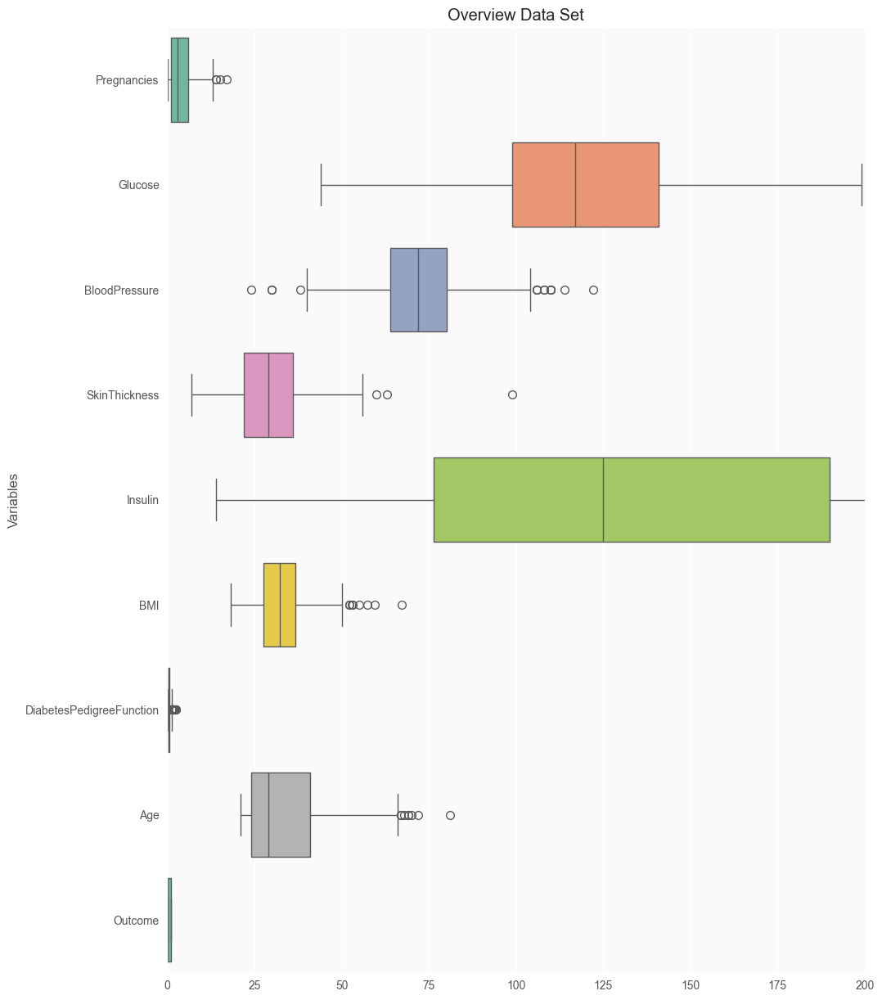

In [9]:
plt.style.use('ggplot')

f,ax = plt.subplots(figsize = (11, 15))

ax.set_facecolor('#fafafa')
ax.set(xlim = (-.05, 200))
plt.ylabel('Variables')
plt.title('Overview Data Set')
ax = sns.boxplot(data = data,
                 orient = 'h',
                 palette = 'Set2')

In [10]:
def correlation_plot():
    correlation = data.corr() # correlation matrix
    matrix_cols = correlation.columns.tolist() # list of columns
    corr_array = np.array(correlation)  # 2D array of correlation values
    
    trace = go.Heatmap(z = corr_array,
                       x = matrix_cols,
                       y = matrix_cols,
                       colorscale = 'Viridis',
                       colorbar = dict(),)
    
    layout = go.Layout(dict(title = 'Correlation Matrix for variables',
                            margin  = dict(r = 0 ,l = 100,
                                           t = 0,b = 100,),
                            yaxis   = dict(tickfont = dict(size = 9)),
                            xaxis   = dict(tickfont = dict(size = 9)),
                           ))
    
    fig = go.Figure(data = [trace], layout = layout)
    py.iplot(fig)


In [11]:
correlation_plot()

In [12]:
def median_target(var):
    temp = data[data[var].notnull()]
    temp = temp[[var, 'Outcome']].groupby(['Outcome'])[[var]].median().reset_index()
    return temp

In [13]:
def plot_distribution(data_select, size_bin):
    tmp1 = D[data_select]
    tmp2 = H[data_select]
    hist_data = [tmp1, tmp2]
    
    group_labels = ['Diabetic', 'Healthy']
    colors = ['gold', 'lightskyblue']
    
    fig = ff.create_distplot(hist_data,
                             group_labels,
                             colors = colors,
                             show_hist = True,
                             bin_size = size_bin,
                             curve_type = 'kde')
    
    fig['layout'].update(title = data_select)
    
    py.iplot(fig, filename = 'Density Plot')
    

In [14]:
plot_distribution('Insulin', 0)

In [15]:
median_target('Insulin')

,Outcome,Insulin
0,0,102.5
1,1,169.5


In [16]:
from sklearn.model_selection import train_test_split

X = data.drop(columns='Outcome')
y = data['Outcome']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)
X_train.shape, X_test.shape, y_train.shape, y_test.shape
X_train.head(), y_train.head()

(     Pregnancies  Glucose  BloodPressure  SkinThickness  Insulin   BMI  \
 353            1     90.0           62.0           12.0     43.0  27.2   
 711            5    126.0           78.0           27.0     22.0  29.6   
 373            2    105.0           58.0           40.0     94.0  34.9   
 46             1    146.0           56.0            NaN      NaN  29.7   
 682            0     95.0           64.0           39.0    105.0  44.6   
 
      DiabetesPedigreeFunction  Age  
 353                     0.580   24  
 711                     0.439   40  
 373                     0.225   25  
 46                      0.564   29  
 682                     0.366   22  ,
 353    0
 711    0
 373    0
 46     0
 682    0
 Name: Outcome, dtype: int64)

In [17]:
cols_to_fix = ['Glucose', 'BloodPressure', 'SkinThickness', 'Insulin', 'BMI']

X_train[cols_to_fix] = X_train[cols_to_fix].replace(0, np.nan)
X_test[cols_to_fix] = X_test[cols_to_fix].replace(0, np.nan)

for col in cols_to_fix:
    median_0 = X_train[y_train == 0][col].median()
    median_1 = X_train[y_train == 1][col].median()
    X_train.loc[(y_train == 0) & (X_train[col].isnull()), col] = median_0
    X_train.loc[(y_train == 1) & (X_train[col].isnull()), col] = median_1
    X_test.loc[(y_test == 0) & (X_test[col].isnull()), col] = median_0
    X_test.loc[(y_test == 1) & (X_test[col].isnull()), col] = median_1

In [18]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


In [19]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=42)
X_train_res, y_train_res = sm.fit_resample(X_train_scaled, y_train)


In [20]:
X_train_df = pd.DataFrame(X_train_res, columns=X_train.columns)
X_test_df = pd.DataFrame(X_test_scaled, columns=X_test.columns)

# N0 - BMI * SkinThickness
X_train_df['N0'] = X_train_df['BMI'] * X_train_df['SkinThickness']
X_test_df['N0'] = X_test_df['BMI'] * X_test_df['SkinThickness']

# N1 - Age <= 30 and Glucose <= 120
X_train_df['N1'] = ((X_train_df['Age'] <= 30) & (X_train_df['Glucose'] <= 120)).astype(int)
X_test_df['N1'] = ((X_test_df['Age'] <= 30) & (X_test_df['Glucose'] <= 120)).astype(int)

# N2 - BMI <= 30
X_train_df['N2'] = (X_train_df['BMI'] <= 30).astype(int)
X_test_df['N2'] = (X_test_df['BMI'] <= 30).astype(int)

# N3 - Age <= 30 and Pregnancies <= 6
X_train_df['N3'] = ((X_train_df['Age'] <= 30) & (X_train_df['Pregnancies'] <= 6)).astype(int)
X_test_df['N3'] = ((X_test_df['Age'] <= 30) & (X_test_df['Pregnancies'] <= 6)).astype(int)

# N4 - Glucose <= 105 and BloodPressure <= 80
X_train_df['N4'] = ((X_train_df['Glucose'] <= 105) & (X_train_df['BloodPressure'] <= 80)).astype(int)
X_test_df['N4'] = ((X_test_df['Glucose'] <= 105) & (X_test_df['BloodPressure'] <= 80)).astype(int)

# N5 - SkinThickness <= 20
X_train_df['N5'] = (X_train_df['SkinThickness'] <= 20).astype(int)
X_test_df['N5'] = (X_test_df['SkinThickness'] <= 20).astype(int)

# N6 - BMI < 30 and SkinThickness <= 20
X_train_df['N6'] = ((X_train_df['BMI'] < 30) & (X_train_df['SkinThickness'] <= 20)).astype(int)
X_test_df['N6'] = ((X_test_df['BMI'] < 30) & (X_test_df['SkinThickness'] <= 20)).astype(int)

# N7 - Glucose <= 105 and BMI <= 30
X_train_df['N7'] = ((X_train_df['Glucose'] <= 105) & (X_train_df['BMI'] <= 30)).astype(int)
X_test_df['N7'] = ((X_test_df['Glucose'] <= 105) & (X_test_df['BMI'] <= 30)).astype(int)

# N8 - Pregnancies / Age
X_train_df['N8'] = X_train_df['Pregnancies'] / (X_train_df['Age'] + 1e-5)
X_test_df['N8'] = X_test_df['Pregnancies'] / (X_test_df['Age'] + 1e-5)

# N9 - Insulin < 200
X_train_df['N9'] = (X_train_df['Insulin'] < 200).astype(int)
X_test_df['N9'] = (X_test_df['Insulin'] < 200).astype(int)

# N10 - BloodPressure < 80
X_train_df['N10'] = (X_train_df['BloodPressure'] < 80).astype(int)
X_test_df['N10'] = (X_test_df['BloodPressure'] < 80).astype(int)

# N11 - Pregnancies < 4 and not zero
X_train_df['N11'] = ((X_train_df['Pregnancies'] < 4) & (X_train_df['Pregnancies'] != 0)).astype(int)
X_test_df['N11'] = ((X_test_df['Pregnancies'] < 4) & (X_test_df['Pregnancies'] != 0)).astype(int)

# N12 - Age * DiabetesPedigreeFunction
X_train_df['N12'] = X_train_df['Age'] * X_train_df['DiabetesPedigreeFunction']
X_test_df['N12'] = X_test_df['Age'] * X_test_df['DiabetesPedigreeFunction']

# N13 - Glucose / DiabetesPedigreeFunction
X_train_df['N13'] = X_train_df['Glucose'] / (X_train_df['DiabetesPedigreeFunction'] + 1e-5)
X_test_df['N13'] = X_test_df['Glucose'] / (X_test_df['DiabetesPedigreeFunction'] + 1e-5)

# N14 - Age / Insulin
X_train_df['N14'] = X_train_df['Age'] / (X_train_df['Insulin'] + 1e-5)
X_test_df['N14'] = X_test_df['Age'] / (X_test_df['Insulin'] + 1e-5)

# N15 - BMI * SkinThickness < 1034
X_train_df['N15'] = (X_train_df['N0'] < 1034).astype(int)
X_test_df['N15'] = (X_test_df['N0'] < 1034).astype(int)


In [21]:
def model_performance(model, subtitle, X, y) :   
    cv = KFold(n_splits=5,shuffle=True, random_state = 42)
    y_real = []
    y_proba = []
    tprs = []
    aucs = []
    mean_fpr = np.linspace(0,1,100)
    i = 1
    
    for train,test in cv.split(X,y):
        model.fit(X.iloc[train], y.iloc[train])
        pred_proba = model.predict_proba(X.iloc[test])
        precision, recall, _ = precision_recall_curve(y.iloc[test], pred_proba[:,1])
        y_real.append(y.iloc[test])
        y_proba.append(pred_proba[:,1])
        fpr, tpr, t = roc_curve(y[test], pred_proba[:, 1])
        tprs.append(interp(mean_fpr, fpr, tpr))
        roc_auc = auc(fpr, tpr)
        aucs.append(roc_auc) 
    
    # Confusion matrix
    y_pred = cross_val_predict(model, X, y, cv=5)
    conf_matrix = confusion_matrix(y, y_pred)
    trace1 = go.Heatmap(z = conf_matrix  ,x = ["0 (pred)","1 (pred)"],
                        y = ["0 (true)","1 (true)"],xgap = 2, ygap = 2, 
                        colorscale = 'Viridis', showscale  = False)
    
    #Show metrics
    tp = conf_matrix[1,1]
    fn = conf_matrix[1,0]
    fp = conf_matrix[0,1]
    tn = conf_matrix[0,0]
    Accuracy  =  ((tp+tn)/(tp+tn+fp+fn))
    Precision =  (tp/(tp+fp))
    Recall    =  (tp/(tp+fn))
    F1_score  =  (2*(((tp/(tp+fp))*(tp/(tp+fn)))/((tp/(tp+fp))+(tp/(tp+fn)))))

    show_metrics = pd.DataFrame(data=[[Accuracy , Precision, Recall, F1_score]])
    show_metrics = show_metrics.T

    colors = ['gold', 'lightgreen', 'lightcoral', 'lightskyblue']
    trace2 = go.Bar(x = (show_metrics[0].values), 
                    y = ['Accuracy', 'Precision', 'Recall', 'F1_score'], text = np.round(show_metrics[0].values,4),
                    textposition = 'auto', textfont=dict(color='black'),
                    orientation = 'h', opacity = 1, marker=dict(
            color=colors,
            line=dict(color='#000000',width=1.5)))

    #Roc curve
    mean_tpr = np.mean(tprs, axis=0)
    mean_auc = auc(mean_fpr, mean_tpr)

    trace3 = go.Scatter(x=mean_fpr, y=mean_tpr,
                        name = "Roc : " ,
                        line = dict(color = ('rgb(22, 96, 167)'),width = 2), fill='tozeroy')
    trace4 = go.Scatter(x = [0,1],y = [0,1],
                        line = dict(color = ('black'),width = 1.5,
                        dash = 'dot'))
    
    #Precision - recall curve
    y_real = y
    y_proba = np.concatenate(y_proba)
    precision, recall, _ = precision_recall_curve(y_real, y_proba)

    trace5 = go.Scatter(x = recall, y = precision,
                        name = "Precision" + str(precision),
                        line = dict(color = ('lightcoral'),width = 2), fill='tozeroy')
    
    mean_auc=round(mean_auc,3)
    #Subplots
    fig = tls.make_subplots(rows=2, cols=2, print_grid=False,
                          specs=[[{}, {}], 
                                 [{}, {}]],
                          subplot_titles=('Confusion Matrix',
                                          'Metrics',
                                          'ROC curve'+" "+ '('+ str(mean_auc)+')',
                                          'Precision - Recall curve',
                                          ))
    #Trace and layout
    fig.append_trace(trace1,1,1)
    fig.append_trace(trace2,1,2)
    fig.append_trace(trace3,2,1)
    fig.append_trace(trace4,2,1)
    fig.append_trace(trace5,2,2)
    
    fig['layout'].update(showlegend = False, title = '<b>Model performance report (5 folds)</b><br>'+subtitle,
                        autosize = False, height = 830, width = 830,
                        plot_bgcolor = 'black',
                        paper_bgcolor = 'black',
                        margin = dict(b = 195), font=dict(color='white'))
    fig["layout"]["xaxis1"].update(color = 'white')
    fig["layout"]["yaxis1"].update(color = 'white')
    fig["layout"]["xaxis2"].update((dict(range=[0, 1], color = 'white')))
    fig["layout"]["yaxis2"].update(color = 'white')
    fig["layout"]["xaxis3"].update(dict(title = "false positive rate"), color = 'white')
    fig["layout"]["yaxis3"].update(dict(title = "true positive rate"),color = 'white')
    fig["layout"]["xaxis4"].update(dict(title = "recall"), range = [0,1.05],color = 'white')
    fig["layout"]["yaxis4"].update(dict(title = "precision"), range = [0,1.05],color = 'white')
    for i in fig['layout']['annotations']:
        i['font'] = titlefont=dict(color='white', size = 14)
    py.iplot(fig)

In [22]:
def scores_table(model, subtitle, X, y):
    scores = ['accuracy', 'precision', 'recall', 'f1', 'roc_auc']
    res = []
    for sc in scores:
        scores = cross_val_score(model, X, y, cv = 5, scoring = sc)
        res.append(scores)
    df = pd.DataFrame(res).T
    df.loc['mean'] = df.mean()
    df.loc['std'] = df.std()
    df= df.rename(columns={0: 'accuracy', 1:'precision', 2:'recall',3:'f1',4:'roc_auc'})

    trace = go.Table(
        header=dict(values=['<b>Fold', '<b>Accuracy', '<b>Precision', '<b>Recall', '<b>F1 score', '<b>Roc auc'],
                    line = dict(color='#7D7F80'),
                    fill = dict(color='#a1c3d1'),
                    align = ['center'],
                    font = dict(size = 15)),
        cells=dict(values=[('1','2','3','4','5','mean', 'std'),
                           np.round(df['accuracy'],3),
                           np.round(df['precision'],3),
                           np.round(df['recall'],3),
                           np.round(df['f1'],3),
                           np.round(df['roc_auc'],3)],
                   line = dict(color='#7D7F80'),
                   fill = dict(color='#EDFAFF'),
                   align = ['center'], font = dict(size = 15)))

    layout = dict(width=800, height=400, title = '<b>Cross Validation - 5 folds</b><br>'+subtitle, font = dict(size = 15))
    fig = dict(data=[trace], layout=layout)

    py.iplot(fig, filename = 'styled_table')

In [23]:
import lightgbm as lgb
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

param_test = {
    'learning_rate': [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
    'n_estimators': [100, 200, 300, 400, 500, 600, 800, 1000, 1500, 2000],
    'num_leaves': sp_randint(6, 50),
    'min_child_samples': sp_randint(100, 500),
    'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
    'subsample': sp_uniform(loc=0.2, scale=0.8),
    'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
    'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
    'reg_alpha': [0, 0.1, 1, 2, 5, 7, 10, 50, 100],
    'reg_lambda': [0, 0.1, 1, 5, 10, 20, 50, 100]
}

# Kaç farklı kombinasyon denensin?
n_iter = 300

# LightGBM modeli (base model)
lgbm_clf = lgb.LGBMClassifier(
    random_state=42,
    silent=True,
    metric=None,
    n_jobs=4
)

# RandomizedSearchCV
grid_search = RandomizedSearchCV(
    estimator=lgbm_clf,
    param_distributions=param_test,
    n_iter=n_iter,
    scoring='accuracy',
    cv=5,
    refit=True,
    random_state=42,
    verbose=1
)

grid_search.fit(
    X_train_df, y_train_res,
    eval_set=[(X_test_df, y_test)],
    callbacks=[
        early_stopping(100),
        log_evaluation(0)
    ]
)


opt_params = grid_search.best_params_
lgbm_clf = lgb.LGBMClassifier(**opt_params, random_state=42)
lgbm_clf.fit(X_train_df, y_train_res)

# Değerlendirme
model_performance(lgbm_clf, subtitle="LightGBM - Best Params (RandomizedSearchCV + New Features)", X=X_train_df, y=y_train_res)
scores_table(lgbm_clf, subtitle="LightGBM - Best Params (RandomizedSearchCV + New Features)", X=X_train_df, y=y_train_res)



Fitting 5 folds for each of 300 candidates, totalling 1500 fits
[LightGBM] [Warning] Unknown parameter: silent
[LightGBM] [Warning] Unknown parameter: silent
[LightGBM] [Info] Number of positive: 320, number of negative: 320
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2039
[LightGBM] [Info] Number of data points in the train set: 640, number of used features: 13
[LightGBM] [Warning] Unknown parameter: silent
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because 

[LightGBM] [Info] Number of positive: 320, number of negative: 320
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000187 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2039
[LightGBM] [Info] Number of data points in the train set: 640, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

=== Test Set Metrics ===
Accuracy  : 0.8636
Precision : 0.8000
Recall  : 0.8148
F1 Score  : 0.8073
ROC AUC : 0.9285


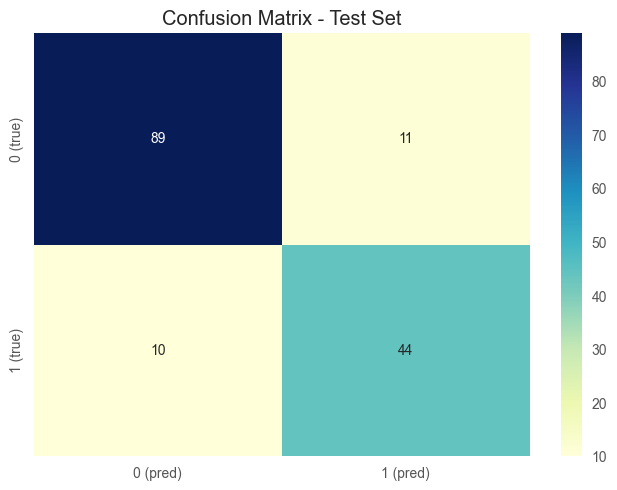

In [24]:
y_test_pred = lgbm_clf.predict(X_test_df)
y_test_proba = lgbm_clf.predict_proba(X_test_df)[:, 1]

# === 4. Metrikler ===
acc = accuracy_score(y_test, y_test_pred)
prec = precision_score(y_test, y_test_pred)
rec = recall_score(y_test, y_test_pred)
f1 = f1_score(y_test, y_test_pred)
roc_auc = roc_auc_score(y_test, y_test_proba)

print("=== Test Set Metrics ===")
print(f"Accuracy  : {acc:.4f}")
print(f"Precision : {prec:.4f}")
print(f"Recall  : {rec:.4f}")
print(f"F1 Score  : {f1:.4f}")
print(f"ROC AUC : {roc_auc:.4f}")

# === 5. Confusion Matrix ===
cm = confusion_matrix(y_test, y_test_pred)
sns.heatmap(cm,
             annot=True,
             fmt='d',
             cmap='YlGnBu',
             xticklabels=['0 (pred)', '1 (pred)'],
             yticklabels=['0 (true)', '1 (true)'])
plt.title('Confusion Matrix - Test Set')
plt.show()

In [25]:
import joblib

joblib.dump(lgbm_clf, 'diabetes_model.pkl')

['diabetes_model.pkl']